2024-04-29 00:54:22.728917: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-29 00:54:22.728987: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-29 00:54:22.730104: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-29 00:54:23.749241: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
The config attributes {'act_fn': 'silu', 'attention_type': 'default', 'center_input_sample': False, 'class_embed_type': None, 'class_embeddings_concat': False, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'cross_attention_norm': None, 'downsam

n-steps: 50, guidance_scale: 7.5, image_guidance_scale: 1.5
Running prompt 0
Running prompt 1
Running prompt 2
Running prompt 3
Running prompt 4
Running prompt 5
Running prompt 6


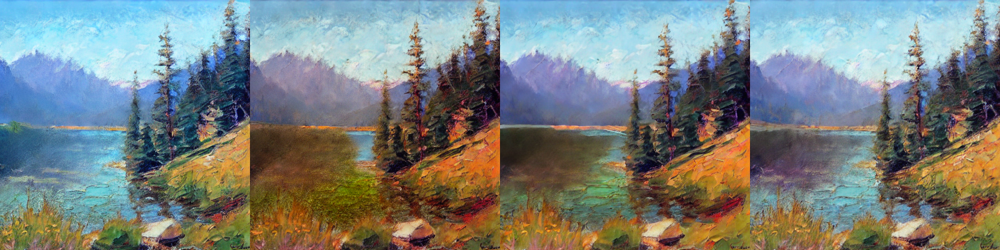

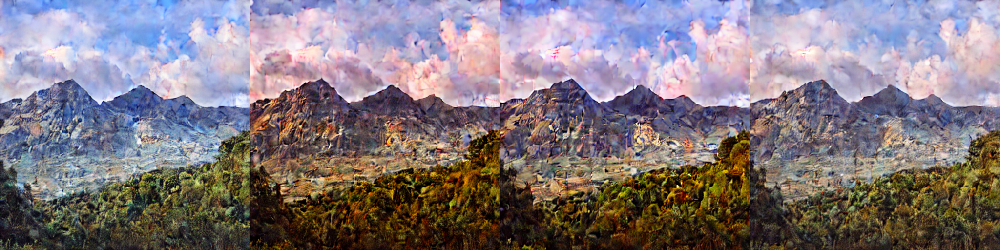

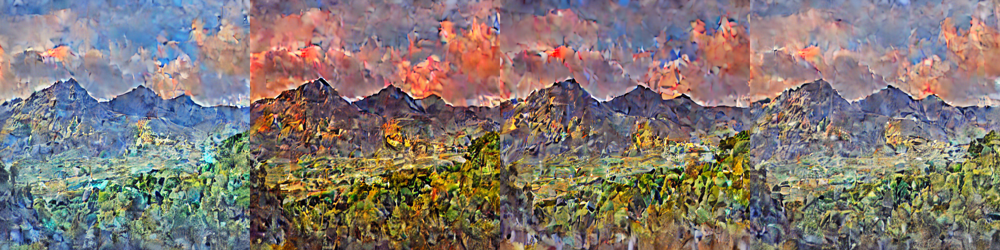

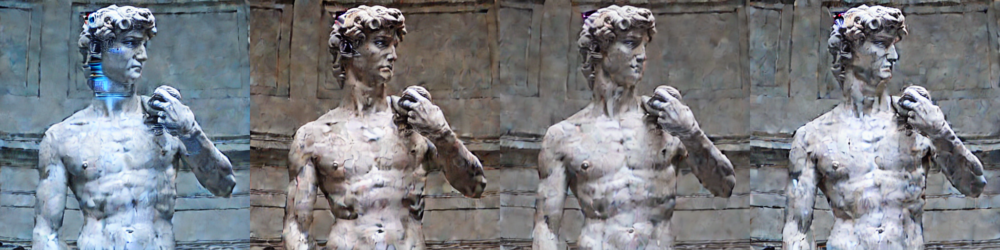

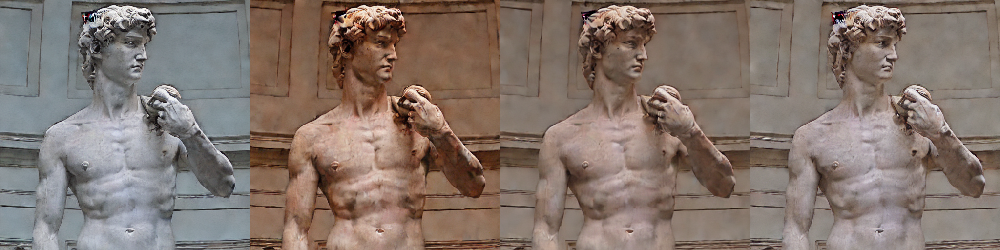

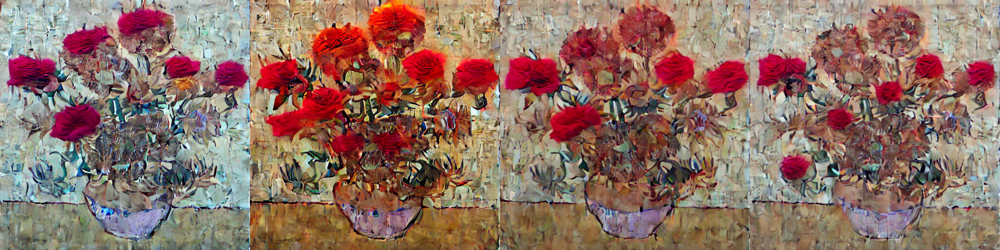

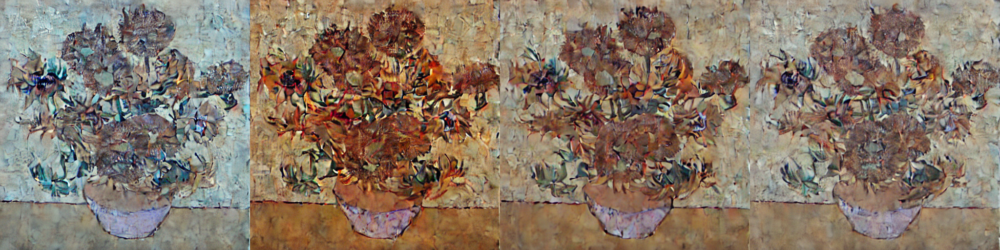

In [1]:
import requests
from io import BytesIO
from PIL import Image
import jax
import numpy as np
import jax.numpy as jnp
from flax.jax_utils import replicate
from flax.training.common_utils import shard
from  flax.serialization import to_bytes, from_bytes
from flax.core.frozen_dict import FrozenDict, unfreeze, freeze
from diffusers.utils import make_image_grid
from diffusers import (
    FlaxStableDiffusionImg2ImgPipeline,
    FlaxStableDiffusionInstructPix2PixPipeline,
    FlaxStableDiffusionImg2ImgPipeline
)

from jax.experimental.compilation_cache import compilation_cache as cc
cc.set_cache_dir("/tmp/sd_cache")

def download_image(url):
    response = requests.get(url)
    return Image.open(BytesIO(response.content)).convert("RGB")

def create_key(seed=0):
    return jax.random.PRNGKey(seed)

pipeline, pipeline_params = FlaxStableDiffusionInstructPix2PixPipeline.from_pretrained(
    # '../flax_models/instruct-pix2pix',
    # '../flax_models/stable-diffusion-v1-5',
    # './instruct-pix2pix-model-parquet',
    'ema-and-05-dropout-instruct-pix2pix-model',
    # './instruct-pix2pix-model', 

    dtype=jnp.bfloat16,
    safety_checker=None
)

LOAD_NON_EMA_PARAMS = False # change if testing non-ema params

if LOAD_NON_EMA_PARAMS:
    params_path = './instruct-pix2pix-model/unet/non_ema.msgpack'

    # Load the EMA parameters from disk
    with open(params_path, 'rb') as f:
        non_ema_params = from_bytes(pipeline_params['unet'], f.read()) # template object (here params['unet']) needs to be isomorphic to the target object

    # Optionally, remove the 'unet' key from the pipeline parameters
    popped_item = pipeline_params.pop('unet', None)

    # Update the pipeline params 
    pipeline_params['non_ema'] = non_ema_params

    # Otherwise, only the EMA parameters are saved to disk under the 'unet' key in the params dictionary


rng = create_key(1371)
num_samples = jax.device_count()
rng = jax.random.split(rng, jax.device_count())
p_params = replicate(pipeline_params)

NUM_INFERENCE_STEPS     = 50
GUIDANCE_SCALE          = 7.5
IMAGE_GUIDANCE_SCALE    = 1.5

def run_pipeline(prompt, image):
    prompt_ids, processed_image = pipeline.prepare_inputs(
        prompt=[prompt] * num_samples, image=[image] * num_samples
    )

    prompt_ids = shard(prompt_ids)
    processed_image = shard(processed_image)
    
    output = pipeline(
        prompt_ids=prompt_ids,
        image=processed_image,
        params=p_params,
        prng_seed=rng,
        num_inference_steps=NUM_INFERENCE_STEPS,
        guidance_scale=GUIDANCE_SCALE,
        image_guidance_scale=IMAGE_GUIDANCE_SCALE,
        height=512,
        width=512,
        jit=True, # include for img2img
    ).images

    output_images = pipeline.numpy_to_pil(np.asarray(output.reshape((num_samples,) + output.shape[-3:])))

    # Grid plot images
    return make_image_grid(output_images, rows=len(output_images)//4, cols=4)


# Run pipeline with multiple prompts and images

text_prompts = [
    "wipe out the lake",
    "make the mountains snowy",
    "Generate a cartoonized version of the image",
    "turn him into a cyborg",
    "Generate a cartoonized version of the image",
    "Swap sunflowers with roses",
    "Generate a cartoonized version of the image",
]
urls = [
    "https://huggingface.co/datasets/sayakpaul/sample-datasets/resolve/main/test_pix2pix_4.png",
    "https://huggingface.co/datasets/diffusers/diffusers-images-docs/resolve/main/mountain.png",
    "https://huggingface.co/datasets/diffusers/diffusers-images-docs/resolve/main/mountain.png",
    "https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg",
    "https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg",
    "https://wehco.media.clients.ellingtoncms.com/img/photos/2019/06/25/vangogh1_t800.png?90232451fbcadccc64a17de7521d859a8f88077d",
    "https://wehco.media.clients.ellingtoncms.com/img/photos/2019/06/25/vangogh1_t800.png?90232451fbcadccc64a17de7521d859a8f88077d",
]

image_prompts = list(map(lambda x : download_image(x).resize((512,512)), urls))
images = []

print(f'n-steps: {NUM_INFERENCE_STEPS}, guidance_scale: {GUIDANCE_SCALE}, image_guidance_scale: {IMAGE_GUIDANCE_SCALE}')

for i in range(len(text_prompts)):
    print(f"Running prompt {i}")
    images.append(run_pipeline(text_prompts[i], image_prompts[i]))

for i in range(len(images)):
    images[i].show()
    




# # %% 
# # Manual testing 


# M, N = 1, 2 # text, image

# run_pipeline(text_prompts[M], image_prompts[N])

# # %%

# # Inference with pretrained model from Hugging Face

# import torch  
# from diffusers import StableDiffusionInstructPix2PixPipeline
# from diffusers import FlaxStableDiffusionInstructPix2PixPipeline

# model_id = 'timbrooks/instruct-pix2pix'
# image = Image.open(BytesIO(requests.get(
#     'https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg'
#     ).content)).convert('RGB')

# prompt='turn him into a cyborg'

# pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(
#     model_id, 
#     torch_dtype=torch.float32, #torch.float16 not supported
#     safety_checker=None
# )

# images = pipe(prompt, image=image).images
# images[0].show()

In [1]:
import os
import math
import PIL
import copy
import argparse
import logging
import requests
import random
from pathlib import Path
from tqdm.auto import tqdm
from typing import Any, Callable, Dict, Optional, Union

import jax
import jax.numpy as jnp
import numpy as np
import optax
from flax import jax_utils
from flax.training import train_state
from flax.training.train_state import TrainState
from flax.training.common_utils import shard
from flax.core.frozen_dict import FrozenDict, unfreeze, freeze
from flax import core, struct
from flax.linen.fp8_ops import OVERWRITE_WITH_GRADIENT

import torch
import torch.utils.checkpoint
from torchvision import transforms
import transformers
from transformers import CLIPImageProcessor, CLIPTokenizer, FlaxCLIPTextModel, set_seed
from datasets import load_dataset
from huggingface_hub import create_repo, upload_folder

from diffusers import (
    FlaxAutoencoderKL,
    FlaxDDPMScheduler,
    FlaxPNDMScheduler,
    FlaxStableDiffusionPipeline,
    FlaxUNet2DConditionModel,
)
from diffusers.pipelines.stable_diffusion import FlaxStableDiffusionSafetyChecker
from diffusers.utils import check_min_version

from jax_dataloader import NumpyLoader, train_dataset 


# Will error if the minimal version of diffusers is not installed. Remove at your own risks.
check_min_version("0.28.0.dev0")

logger = logging.getLogger(__name__)

DATASET_NAME_MAPPING = {
    "fusing/instructpix2pix-1000-samples": ("input_image", "edit_prompt", "edited_image"),
}
WANDB_TABLE_COL_NAMES = ["original_image", "edited_image", "edit_prompt"]

# convert the namespace to a dictionary
args = {
'pretrained_model_name_or_path': 'runwayml/stable-diffusion-v1-5',
'revision': 'bf16',
'variant': None,
'dataset_name': 'fusing/instructpix2pix-1000-samples',
'dataset_config_name': None,
'train_data_dir': None,
'original_image_column': 'input_image',
'edited_image_column': 'edited_image',
'edit_prompt_column': 'edit_prompt',
'val_image_url': None,
'validation_prompt': None,
'num_validation_images': 4,
'validation_epochs': 1,
'max_train_samples': None,
'output_dir': 'instruct-pix2pix-model',
'cache_dir': None,
'seed': 42,
'resolution': 4,
'center_crop': False,
'random_flip': True,
'train_batch_size': 4,
'num_train_epochs': 100,
'max_train_steps': 15000,
'gradient_accumulation_steps': 4,
'gradient_checkpointing': True,
'learning_rate': 5e-05,
'scale_lr': False,
'lr_scheduler': 'constant',
'lr_warmup_steps': 0,
'conditioning_dropout_prob': 0.05,
'use_8bit_adam': False,
'allow_tf32': False,
'use_ema': False,
'non_ema_revision': None,
'dataloader_num_workers': 0,
'adam_beta1': 0.9,
'adam_beta2': 0.999,
'adam_weight_decay': 0.01,
'adam_epsilon': 1e-08,
'max_grad_norm': 1.0,
'push_to_hub': True,
'hub_token': None,
'hub_model_id': None,
'logging_dir': 'logs',
'mixed_precision': 'bf16',
'report_to': 'tensorboard',
'local_rank': -1,
'checkpointing_steps': 5000,
'checkpoints_total_limit': 1,
'resume_from_checkpoint': None,
'enable_xformers_memory_efficient_attention': True,
'from_pt': False,
'max_ema_decay': 0.999,
'min_ema_decay': 0.5,
'ema_decay_power': 0.6666666,
'ema_inv_gamma': 1.0,
'start_ema_update_after': 100,
'update_ema_every': 10,
}

class Args:
    def __init__(self, **entries):
        self.__dict__.update(entries) 
args = Args(**args)


logging.basicConfig(
    format="%(asctime)s - %(levelname)s - %(name)s - %(message)s",
    datefmt="%m/%d/%Y %H:%M:%S",
    level=logging.INFO,)
# Setup logging, we only want one process per machine to log things on the screen.
logger.setLevel(logging.INFO if jax.process_index() == 0 else logging.ERROR)
if jax.process_index() == 0:
    transformers.utils.logging.set_verbosity_info()
else:
    transformers.utils.logging.set_verbosity_error()

if args.seed is not None: set_seed(args.seed)


# (1) Data loader: Creates a JAX generator from a standard PyTorch dataloader
train_dataloader = NumpyLoader(
    train_dataset, 
    batch_size=args.train_batch_size,
    num_workers= 0
)


# (5) Conditioning dropout implementation


def xapply_conditioning_dropout(encoder_hidden_states, original_image_embeds, dropout_rng, bsz, args):
    print("Encoder hidden states: ", encoder_hidden_states.shape, ' original_image_embeds.shape, ', original_image_embeds.shape, 'BSZ: ', bsz)

    # Make sure bsz is a static, concrete number
    random_p = jax.random.uniform(dropout_rng, shape=(bsz,), minval=0.0, maxval=1.0)

    print("Random p: ", random_p, random_p.shape)

    prompt_mask = random_p < 2 * args.conditioning_dropout_prob

    print("Prompt mask: ", prompt_mask, prompt_mask.shape)
    print('Tokenize captions: ', tokenize_captions([""]).shape)

    null_text_conditioning = text_encoder(tokenize_captions([""]), params=text_encoder.params, train=False)[0]

    print("Null text conditioning: ", null_text_conditioning.shape)
    print(prompt_mask[:, None, None].shape, null_text_conditioning.shape, encoder_hidden_states.shape   )

    encoder_hidden_states = jnp.where(prompt_mask[:, None, None], null_text_conditioning, encoder_hidden_states)

    print("Encoder hidden states: ", encoder_hidden_states.shape)

    image_mask = (random_p >= args.conditioning_dropout_prob) & (random_p < 3 * args.conditioning_dropout_prob)

    print("Image mask: ", image_mask, image_mask.shape)

    image_mask = image_mask[:, None, None, None]  # Adjust the mask shape to match the embeddings shape

    print("Image mask: ", image_mask, image_mask.shape) 

    original_image_embeds = original_image_embeds * image_mask
    print("Original image embeds: ",original_image_embeds.shape)

    return encoder_hidden_states, original_image_embeds

def tokenize_captions(captions):
    inputs = tokenizer(
        captions, max_length=tokenizer.model_max_length, padding="max_length", truncation=True, return_tensors="np")
    return inputs.input_ids

def apply_conditioning_dropout(encoder_hidden_states, original_image_embeds, dropout_rng, bsz, args):

    # Make sure bsz is a static, concrete number
    # Generating a random tensor `random_p` with shape (bsz,)
    random_p = jax.random.uniform(dropout_rng , (bsz,))

    # Generating the prompt mask
    prompt_mask = random_p < 2 * args.conditioning_dropout_prob
    prompt_mask = prompt_mask.reshape(bsz, 1, 1)  # Reshape to match dimensions for broadcasting
    null_text_conditioning = text_encoder(tokenize_captions([""]), params=text_encoder.params, train=False)[0]

    # Applying null conditioning using the prompt mask
    updated_encoder_hidden_states = jnp.where(prompt_mask, null_text_conditioning, encoder_hidden_states)

    # Generating the image mask
    image_mask_dtype = original_image_embeds.dtype
    image_mask = 1 - (
        (random_p >= args.conditioning_dropout_prob).astype(image_mask_dtype)
        * (random_p < 3 * args.conditioning_dropout_prob).astype(image_mask_dtype)
    )
    image_mask = image_mask.reshape(bsz, 1, 1, 1)
    
    # Final image conditioning.
    original_image_embeds = image_mask * original_image_embeds
    
    return updated_encoder_hidden_states, original_image_embeds

# apply_conditioning_dropout(jnp.ones((4,77,768)), jnp.ones((4,4,32,32)), jax.random.PRNGKey(42), 4, args);







# (2) Models and state

weight_dtype = jnp.float32
if args.mixed_precision == "fp16":
    weight_dtype = jnp.float16
elif args.mixed_precision == "bf16":
    weight_dtype = jnp.bfloat16


# NOTE: Hugging Face uses variants (`bfloat16` or `flax`) to refer to different repository branches and hence different checkpoints. 
# The `bfloat16` branch/variant refers to `EMA only weights` (parameters where smoothed out during training) and `flax` refers to the `raw weights` (no EMA smoothing used during training).

# That is, the difference between the two checkpoints is the whether the EMA smoothing was applied or not:
# v1-5-pruned-emaonly.ckpt: This checkpoint uses only the EMA weights. EMA is a technique used during training to stabilize and improve the convergence properties of the model. It smooths the model parameters over the course of training by maintaining a running average of model weights. Using EMA weights typically results in a model that generalizes better on new, unseen data.
# v1-5-pruned.ckpt: This checkpoint likely includes the "raw" final weights obtained at the end of training, without applying the EMA smoothing. This means it could potentially be less smooth or stable compared to the EMA-only model, but it might capture nuances that the EMA-smoothed model does not.

# See timothybrooks/instruct-pix2pix/scripts/download_pretrained_sd.sh for the exact checkpoints used:
# https://huggingface.co/runwayml/stable-diffusion-v1-5/resolve/main/v1-5-pruned-emaonly.ckpt
# https://huggingface.co/stabilityai/sd-vae-ft-mse-original/resolve/main/vae-ft-mse-840000-ema-pruned.ckpt

assert args.revision=="bf16", "Instruct-Pix2Pix was fine-tuned on a v1-5-pruned-emaonly.ckpt checkpoint, which corresonds to Hugging Face's git identifier revision='bf16'. Please set the revision to 'bf16'."
# NOTE: OSError: bfloat16 is not a valid git identifier (branch name, tag name or commit id) that exists for this model name. Check the model page at 'https://huggingface.co/runwayml/stable-diffusion-v1-5' for available revisions.
assert weight_dtype==jnp.bfloat16, "Please set the mixed_precision to 'bf16' to match the model's weights."

tokenizer = CLIPTokenizer.from_pretrained(
    args.pretrained_model_name_or_path,
    from_pt=args.from_pt,
    revision="bf16", # corresponds to bfloat16 precision, use flax for float32
    subfolder="tokenizer",
)
text_encoder = FlaxCLIPTextModel.from_pretrained(
    args.pretrained_model_name_or_path,
    from_pt=args.from_pt,
    revision="bf16", # corresponds to bfloat16 precision, use flax for float32
    subfolder="text_encoder",
    dtype=weight_dtype,
)
vae, vae_params = FlaxAutoencoderKL.from_pretrained(
    args.pretrained_model_name_or_path,
    from_pt=args.from_pt,
    revision="flax", # NOTE: the vae model uses the `flax` revision for the raw weights (no EMA smoothing)
    subfolder="vae",
    dtype=weight_dtype,
)

# Load the converted unet model
save_dir = 'modified_unet'
unet, unet_params = FlaxUNet2DConditionModel.from_pretrained(
    save_dir,
    dtype=jnp.bfloat16 # NOTE: from a EMA-only checkpoint, in fp32 precision, converted to Flax using the save_unet.py script, and then loaded in bfloat16 precision here!
)


# (3) Helper functions

def get_nparams(params: FrozenDict) -> int:
    nparams = 0
    for item in params:
        if isinstance(params[item], FrozenDict) or isinstance(params[item], dict):
            nparams += get_nparams(params[item])
        else:
            nparams += params[item].size
    return nparams

def retrieve_latents_jax(image, vae, vae_params, key=None, sample_mode="sample"):
    # pass the image through the VAE to get the latents
    encoder_output = vae.apply(
                {"params": vae_params}, image, deterministic=True, method=vae.encode)

    # get the latent distribution
    latent_dist = encoder_output.latent_dist 

    if sample_mode == "sample":
        return latent_dist.sample(key)
    elif sample_mode == "argmax":
        return latent_dist.mode()
    elif sample_mode == "latents":
        return encoder_output.latents
    else:
        raise ValueError(f"Invalid sample_mode: {sample_mode}")


# (4) EMA implementation

# def get_decay(
#     step: int, max_ema_decay: float = 0.9999,
#     min_ema_decay: float = 0.0,
#     ema_inv_gamma: float = 1.0,
#     ema_decay_power: float = 2 / 3, 
#     use_ema_warmup: bool = False,
#     start_ema_update_after_n_steps: float = 10.0
#     ):
#     # Adjust step to consider the start update offset
#     adjusted_step = jnp.maximum(step - start_ema_update_after_n_steps, 0)

#     # Compute base decay
#     if use_ema_warmup:
#         decay = 1.0 - (1.0 + adjusted_step / ema_inv_gamma) ** -ema_decay_power
#     else:
#         initial_steps = jnp.where(start_ema_update_after_n_steps == 0, 10.0, start_ema_update_after_n_steps)
#         decay = (1.0 + adjusted_step) / (initial_steps + adjusted_step)

#     # Ensure decay starts changing only after certain steps
#     decay = jnp.where(step > start_ema_update_after_n_steps, decay, min_ema_decay)

#     # Clip the decay to ensure it stays within the specified bounds
#     return jnp.clip(decay, min_ema_decay, max_ema_decay)

# class EMAState(struct.PyTreeNode):
#     ema_params: core.FrozenDict[str, Any] = struct.field(pytree_node=True)
#     # add a decay function to the EMAState
#     decay_fn: Callable[[float], "EMAState"] = struct.field(pytree_node=False)

# class ExtendedTrainState(TrainState, EMAState):
#     def apply_gradients(self, grads: core.FrozenDict[str, Any], ema_decay: float = 0.999) -> "ExtendedTrainState":
#         # Standard parameter update
#         updates, new_opt_state = self.tx.update(grads, self.opt_state, self.params)
#         new_params = optax.apply_updates(self.params, updates)
        
#         ema_decay = self.decay_fn( self.step,) 

#         # Update EMA parameters
#         new_ema_params = jax.tree.map(
#             lambda ema, p: ema * ema_decay + (1 - ema_decay) * p, self.ema_params, new_params
#         )
        
#         return self.replace(params=new_params, opt_state=new_opt_state, ema_params=new_ema_params)




#def main():


# Optimization

total_train_batch_size = args.train_batch_size * jax.local_device_count()
if args.scale_lr:
    args.learning_rate = args.learning_rate * total_train_batch_size

constant_scheduler = optax.constant_schedule(args.learning_rate)

adamw = optax.adamw(
    learning_rate=constant_scheduler,
    b1=args.adam_beta1,
    b2=args.adam_beta2,
    eps=args.adam_epsilon,
    weight_decay=args.adam_weight_decay,
)

optimizer = optax.chain(
    optax.clip_by_global_norm(args.max_grad_norm),
    adamw,
)

print("Number of unet parameters: ", get_nparams(unet_params))

# # Initialize EMA params with original model params
# ema_params = copy.deepcopy(unet_params)
# print("Number of EMA parameters: ", get_nparams(ema_params))

# Prepare optimizer and state, including EMA parameters
# state = train_state.TrainState.create(apply_fn=unet.__call__, params=unet_params, tx=optimizer)
# state = ExtendedTrainState.create(apply_fn=unet.__call__, params=unet_params, ema_params=ema_params, decay_fn=get_decay, tx=optimizer)

# Simplified decay function (matching PyTorch's EMAModel)
def get_decay(step: int, decay: float = 0.9999):
    return decay

# Extended decay function 
def get_decay(
    step: int, max_ema_decay: float = 0.9999,
    min_ema_decay: float = 0.0,
    ema_inv_gamma: float = 1.0,
    ema_decay_power: float = 2 / 3, 
    use_ema_warmup: bool = False,
    start_ema_update_after_n_steps: float = 10.0
    ):
    """
    Computes the EMA decay factor based on the current step and a dynamic decay rate.
    """
    # Adjust step to consider the start update offset
    adjusted_step = jnp.maximum(step - start_ema_update_after_n_steps, 0)

    # Compute base decay
    if use_ema_warmup:
        decay = 1.0 - (1.0 + adjusted_step / ema_inv_gamma) ** -ema_decay_power
    else:
        initial_steps = jnp.where(start_ema_update_after_n_steps == 0, 10.0, start_ema_update_after_n_steps)
        decay = (1.0 + adjusted_step) / (initial_steps + adjusted_step)

    # Ensure decay starts changing only after certain steps
    decay = jnp.where(step > start_ema_update_after_n_steps, decay, min_ema_decay)

    # Clip the decay to ensure it stays within the specified bounds
    return jnp.clip(decay, min_ema_decay, max_ema_decay)
#     return jnp.clip(decay, min_ema_decay, max_ema_decay)

@jax.jit
def ema_update(new_params, ema_params, ema_decay):
    # Update EMA parameters
    # return jax.tree.map(lambda ema, p: ema * decay + p * (1 - decay), ema_params, params)
    new_ema_params = jax.tree.map(
        lambda ema, p: ema * ema_decay + (1 - ema_decay) * p, ema_params, new_params
    )
    return new_ema_params

class ExtendedTrainState(TrainState):
    ema_params: core.FrozenDict[str, Any]
    #decay_function: Callable[[int], float]

    def apply_gradients(self, grads: core.FrozenDict[str, Any]) -> "ExtendedTrainState":
        # Standard parameter update
        updates, new_opt_state = self.tx.update(grads, self.opt_state, self.params)
        new_params = optax.apply_updates(self.params, updates)

        # Update EMA parameters using the decay function
        # decay = self.decay_fn(self.step)  # Using extended_get_decay
        #decay = get_decay(self.step)  # NOTE: set decay function here
        # new_ema_params = ema_update(new_params, self.ema_params, decay)

        return self.replace(params=new_params, opt_state=new_opt_state, ema_params=self.ema_params)


# Initialize EMA params with original model params
ema_params = copy.deepcopy(unet_params)

# Prepare optimizer and state
state = ExtendedTrainState.create(
    apply_fn=unet.__call__, params=unet_params, ema_params=ema_params, tx=optimizer
)

noise_scheduler = FlaxDDPMScheduler(
    beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=1000
)
noise_scheduler_state = noise_scheduler.create_state()

# Initialize our training
rng = jax.random.PRNGKey(args.seed)
train_rngs = jax.random.split(rng, jax.local_device_count())

# Training function 
def train_step(state, text_encoder_params, vae_params, batch, train_rng):
    dropout_rng, sample_rng, new_train_rng = jax.random.split(train_rng, 3)

    def compute_loss(params):
        # Convert images to latent space
        vae_outputs = vae.apply(
            {"params": vae_params}, batch["edited_pixel_values"], deterministic=True, method=vae.encode
        )
        latents = vae_outputs.latent_dist.sample(sample_rng)
        latents = jnp.einsum("ijkl->iljk", latents) * vae.config.scaling_factor  # (NHWC) -> (NCHW)
        noise_rng, timestep_rng = jax.random.split(sample_rng)

        # Sample noise that we'll add to the latents
        noise = jax.random.normal(noise_rng, latents.shape)

        # Sample a random timestep for each image
        bsz = latents.shape[0]
        timesteps = jax.random.randint(
            timestep_rng,
            (bsz,),
            0,
            noise_scheduler.config.num_train_timesteps,
        )
        # Add noise to the latents according to the noise magnitude at each timestep
        # (this is the forward diffusion process)
        noisy_latents = noise_scheduler.add_noise(noise_scheduler_state, latents, noise, timesteps)

        # Get the text embedding for conditioning
        encoder_hidden_states = text_encoder(
            batch["input_ids"],
            params=text_encoder_params,
            train=False,
        )[0]

        # Get the additional image embedding for conditioning.
        # Instead of getting a diagonal Gaussian here, we simply take the mode.
        vae_image_outputs = vae.apply(
            {"params": vae_params}, batch["original_pixel_values"], deterministic=True, method=vae.encode
        )
        original_image_embeds = vae_image_outputs.latent_dist.mode()
        original_image_embeds = jnp.einsum("ijkl->iljk", original_image_embeds) # (NHWC) -> (NCHW)

        # TODO: Classifier-Free Guidance (conditioning dropout)
        # encoder_hidden_states, original_image_embeds = apply_conditioning_dropout(encoder_hidden_states, original_image_embeds, dropout_rng, bsz, args)

        # Concatenate the noisy latents with the original image embeddings
        concatenated_noisy_latents = jnp.concatenate([noisy_latents, original_image_embeds], axis=1)

        # Predict the noise residual and compute loss
        model_pred = unet.apply(
            {"params": params}, concatenated_noisy_latents, timesteps, encoder_hidden_states, train=True
        ).sample

        # Get the target for loss depending on the prediction type
        if noise_scheduler.config.prediction_type == "epsilon":
            target = noise
        elif noise_scheduler.config.prediction_type == "v_prediction":
            target = noise_scheduler.get_velocity(noise_scheduler_state, latents, noise, timesteps)
        else:
            raise ValueError(f"Unknown prediction type {noise_scheduler.config.prediction_type}")

        loss = (target - model_pred) ** 2
        loss = loss.mean()

        return loss

    grad_fn = jax.value_and_grad(compute_loss)
    loss, grad = grad_fn(state.params)
    grad = jax.lax.pmean(grad, "batch")
    # Update model parameters
    new_state = state.apply_gradients(grads=grad)
    
    # Apply EMA update 
    decay = get_decay(state.step)
    new_ema_params = ema_update(new_state.params, state.ema_params, decay)

    new_state = new_state.replace(ema_params=new_ema_params) 

    metrics = {"loss": loss}
    metrics = jax.lax.pmean(metrics, axis_name="batch")

    return new_state, metrics, new_train_rng


# Create parallel version of the train step
p_train_step = jax.pmap(train_step, "batch", donate_argnums=(0,))

# Replicate the train state on each device
state = jax_utils.replicate(state)
text_encoder_params = jax_utils.replicate(text_encoder.params)
vae_params = jax_utils.replicate(vae_params)

# Train!
len_train_dataset =  train_dataloader.dataset_len

num_update_steps_per_epoch = math.ceil(len_train_dataset)

# Scheduler and math around the number of training steps.
if args.max_train_steps is None:
    args.max_train_steps = args.num_train_epochs * num_update_steps_per_epoch

#args.max_train_steps = math.ceil(args.max_train_steps*(4/total_train_batch_size))
args.num_train_epochs = math.ceil(args.max_train_steps / num_update_steps_per_epoch)
logger.info("***** Running training *****")
logger.info(f"  Num examples = {len_train_dataset}")
logger.info(f"  Num Epochs = {args.num_train_epochs}")
logger.info(f"  Instantaneous batch size per device = {args.train_batch_size}")
logger.info(f"  Total train batch size (w. parallel & distributed) = {total_train_batch_size}")
logger.info(f"  Total optimization steps = {args.max_train_steps}")



global_step = 0
epochs = tqdm(range(args.num_train_epochs), desc="Epoch ... ", position=0)
for epoch in epochs:
    # ======================== Training ================================
    train_metrics = []

    steps_per_epoch = len_train_dataset // total_train_batch_size
    train_step_progress_bar = tqdm(total=steps_per_epoch, desc="Training...", position=1, leave=False)
    # train
    for batch in train_dataloader:
        batch = shard(batch)
        state, train_metric, train_rngs = p_train_step(state, text_encoder_params, vae_params, batch, train_rngs)
        train_metrics.append(train_metric)

        train_step_progress_bar.update(1)

        global_step += 1
        if global_step >= args.max_train_steps:
            break

    train_metric = jax_utils.unreplicate(train_metric)

    train_step_progress_bar.close()
    epochs.write(f"Epoch... ({epoch + 1}/{args.num_train_epochs} | Loss: {train_metric['loss']})")


# Save trained model

def get_params_to_save(params):
    return jax.device_get(jax.tree_util.tree_map(lambda x: x[0], params))

# Create the pipeline using using the trained modules and save it.
if jax.process_index() == 0:
    scheduler = FlaxPNDMScheduler(
        beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", skip_prk_steps=True
    )
    safety_checker = FlaxStableDiffusionSafetyChecker.from_pretrained(
        "CompVis/stable-diffusion-safety-checker", from_pt=True
    )
    pipeline = FlaxStableDiffusionPipeline(
        text_encoder=text_encoder,
        vae=vae,
        unet=unet,
        tokenizer=tokenizer,
        scheduler=scheduler,
        safety_checker=safety_checker,
        feature_extractor=CLIPImageProcessor.from_pretrained("openai/clip-vit-base-patch32"),
    )

    pipeline.save_pretrained(
        args.output_dir,
        params={
            "text_encoder": get_params_to_save(text_encoder_params),
            "vae": get_params_to_save(vae_params),
            "unet": get_params_to_save(state.ema_params),
            # "ema": get_params_to_save(state.ema_params),    
            # "tx": get_params_to_save(state.tx),
            "safety_checker": safety_checker.params,
        },
    )

2024-04-29 00:57:45.847216: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-29 00:57:45.847297: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-29 00:57:45.848424: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-29 00:57:46.759219: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
loading file vocab.json from cache at /home/v/.cache/huggingface/hub/models--timbrooks--instruct-pix2pix/snapshots/31519b5cb02a7fd89b906d88731cd4d6a7bbf88d/tokenizer/vocab.json
loading file merges.txt from cache at /home/v/.cache/huggingface

Number of unet parameters:  859532484


04/29/2024 00:58:24 - INFO - __main__ - ***** Running training *****
04/29/2024 00:58:24 - INFO - __main__ -   Num examples = 1000
04/29/2024 00:58:24 - INFO - __main__ -   Num Epochs = 15
04/29/2024 00:58:24 - INFO - __main__ -   Instantaneous batch size per device = 4
04/29/2024 00:58:24 - INFO - __main__ -   Total train batch size (w. parallel & distributed) = 16
04/29/2024 00:58:24 - INFO - __main__ -   Total optimization steps = 15000


Epoch ... :   0%|          | 0/15 [00:00<?, ?it/s]

Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (1/15 | Loss: 0.5040401816368103)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (2/15 | Loss: 0.12466557323932648)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (3/15 | Loss: 0.08092676103115082)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (4/15 | Loss: 0.26392823457717896)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (5/15 | Loss: 0.1276921033859253)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (6/15 | Loss: 0.03986358642578125)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (7/15 | Loss: 0.12671363353729248)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (8/15 | Loss: 0.16134940087795258)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (9/15 | Loss: 0.10248084366321564)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (10/15 | Loss: 0.1545199155807495)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (11/15 | Loss: 0.08457998186349869)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (12/15 | Loss: 0.02512410655617714)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (13/15 | Loss: 0.07363250851631165)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (14/15 | Loss: 0.21552684903144836)


Training...:   0%|          | 0/62 [00:00<?, ?it/s]

Epoch... (15/15 | Loss: 0.058052752166986465)


loading configuration file config.json from cache at /home/v/.cache/huggingface/hub/models--CompVis--stable-diffusion-safety-checker/snapshots/cb41f3a270d63d454d385fc2e4f571c487c253c5/config.json
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
`text_config` is `None`. Initializing the `CLIPTextConfig` with default values.
`vision_config` is `None`. initializing the `CLIPVisionConfig` with default values.
Model config CLIPConfig {
  "_name_or_path": "clip-vit-large-patch14/",
  "architectures": [
    "SafetyChecker"
  ],
  "initializer_factor": 1.0,
  "logit_scale_init_value": 2.6592,
  "model_type": "clip",
  "projection_

2024-04-29 01:17:55.393879: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-29 01:17:55.393952: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-29 01:17:55.395318: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-29 01:17:56.399129: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
The config attributes {'act_fn': 'silu', 'attention_type': 'default', 'center_input_sample': False, 'class_embed_type': None, 'class_embeddings_concat': False, 'conv_in_kernel': 3, 'conv_out_kernel': 3, 'cross_attention_norm': None, 'downsam

n-steps: 50, guidance_scale: 7.5, image_guidance_scale: 1.5
Running prompt 0
Running prompt 1
Running prompt 2
Running prompt 3
Running prompt 4
Running prompt 5
Running prompt 6


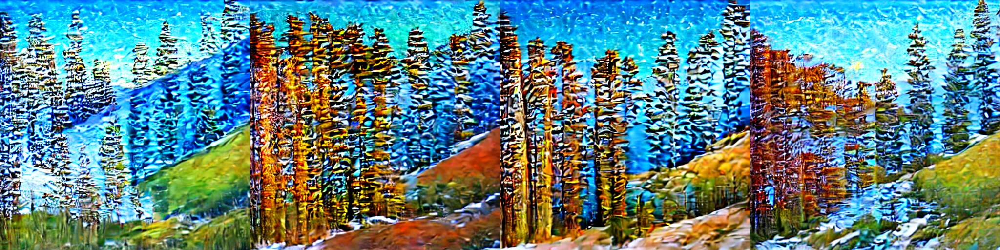

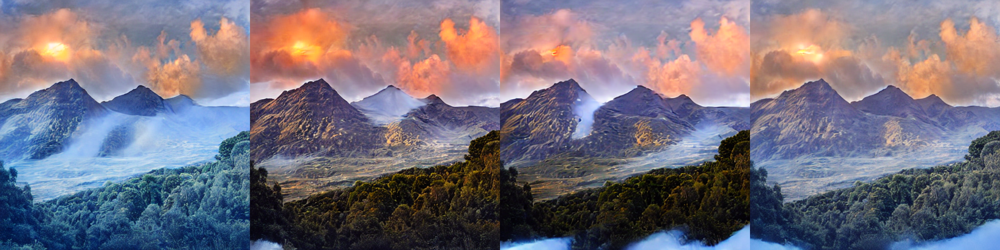

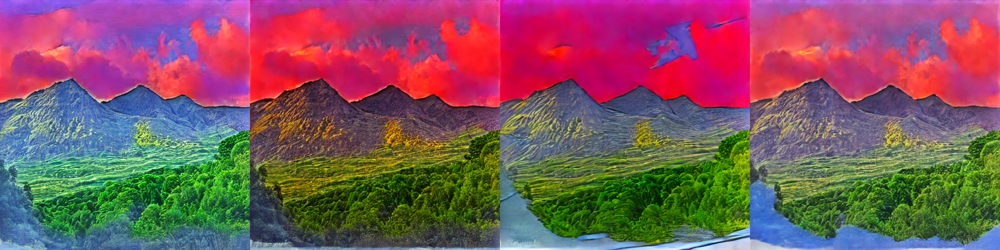

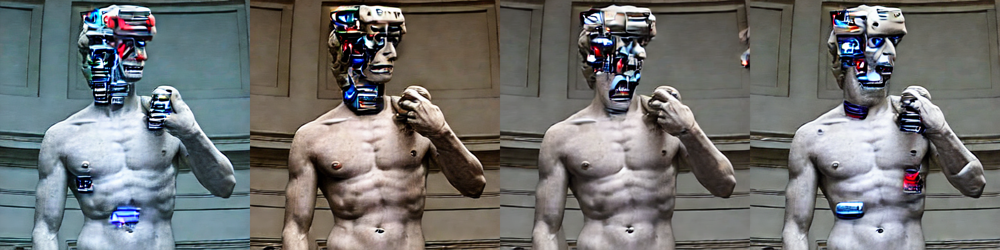

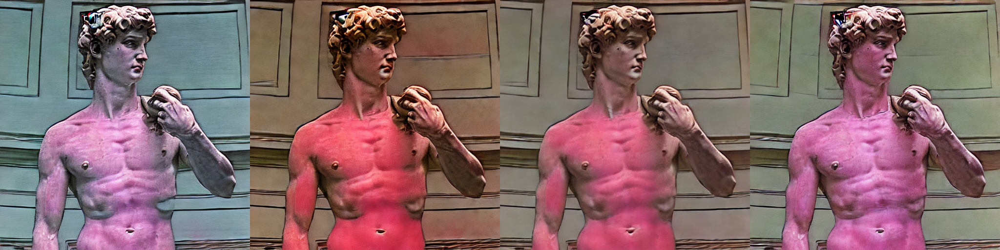

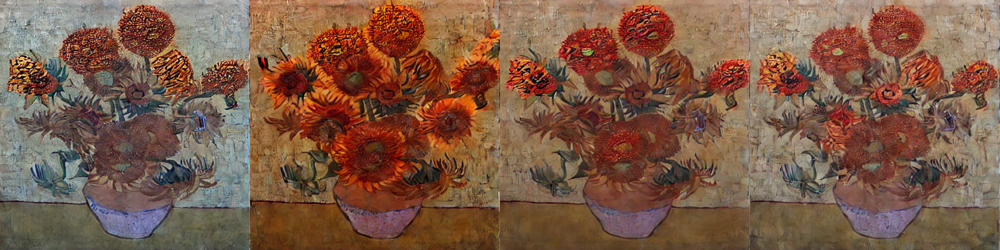

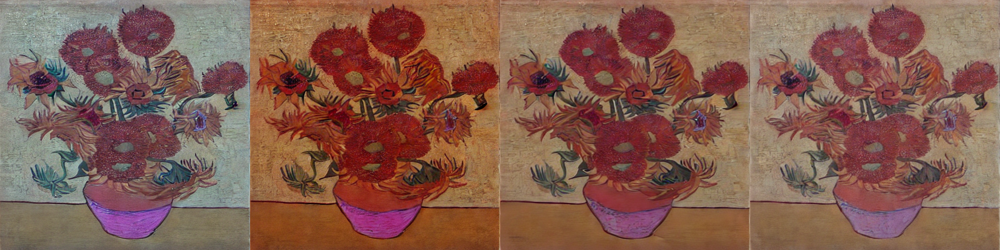

In [1]:
import requests
from io import BytesIO
from PIL import Image
import jax
import numpy as np
import jax.numpy as jnp
from flax.jax_utils import replicate
from flax.training.common_utils import shard
from  flax.serialization import to_bytes, from_bytes
from flax.core.frozen_dict import FrozenDict, unfreeze, freeze
from diffusers.utils import make_image_grid
from diffusers import (
    FlaxStableDiffusionImg2ImgPipeline,
    FlaxStableDiffusionInstructPix2PixPipeline,
    FlaxStableDiffusionImg2ImgPipeline
)

from jax.experimental.compilation_cache import compilation_cache as cc
cc.set_cache_dir("/tmp/sd_cache")

def download_image(url):
    response = requests.get(url)
    return Image.open(BytesIO(response.content)).convert("RGB")

def create_key(seed=0):
    return jax.random.PRNGKey(seed)

pipeline, pipeline_params = FlaxStableDiffusionInstructPix2PixPipeline.from_pretrained(
    # '../flax_models/instruct-pix2pix',
    # '../flax_models/stable-diffusion-v1-5',
    # './instruct-pix2pix-model-parquet',
    # 'ema-and-05-dropout-instruct-pix2pix-model',
    './instruct-pix2pix-model', 

    dtype=jnp.bfloat16,
    safety_checker=None
)

LOAD_NON_EMA_PARAMS = False # change if testing non-ema params

if LOAD_NON_EMA_PARAMS:
    params_path = './instruct-pix2pix-model/unet/non_ema.msgpack'

    # Load the EMA parameters from disk
    with open(params_path, 'rb') as f:
        non_ema_params = from_bytes(pipeline_params['unet'], f.read()) # template object (here params['unet']) needs to be isomorphic to the target object

    # Optionally, remove the 'unet' key from the pipeline parameters
    popped_item = pipeline_params.pop('unet', None)

    # Update the pipeline params 
    pipeline_params['non_ema'] = non_ema_params

    # Otherwise, only the EMA parameters are saved to disk under the 'unet' key in the params dictionary


rng = create_key(1371)
num_samples = jax.device_count()
rng = jax.random.split(rng, jax.device_count())
p_params = replicate(pipeline_params)

NUM_INFERENCE_STEPS     = 50
GUIDANCE_SCALE          = 7.5
IMAGE_GUIDANCE_SCALE    = 1.5

def run_pipeline(prompt, image):
    prompt_ids, processed_image = pipeline.prepare_inputs(
        prompt=[prompt] * num_samples, image=[image] * num_samples
    )

    prompt_ids = shard(prompt_ids)
    processed_image = shard(processed_image)
    
    output = pipeline(
        prompt_ids=prompt_ids,
        image=processed_image,
        params=p_params,
        prng_seed=rng,
        num_inference_steps=NUM_INFERENCE_STEPS,
        guidance_scale=GUIDANCE_SCALE,
        image_guidance_scale=IMAGE_GUIDANCE_SCALE,
        height=512,
        width=512,
        jit=True, # include for img2img
    ).images

    output_images = pipeline.numpy_to_pil(np.asarray(output.reshape((num_samples,) + output.shape[-3:])))

    # Grid plot images
    return make_image_grid(output_images, rows=len(output_images)//4, cols=4)


# Run pipeline with multiple prompts and images

text_prompts = [
    "wipe out the lake",
    "make the mountains snowy",
    "Generate a cartoonized version of the image",
    "turn him into a cyborg",
    "Generate a cartoonized version of the image",
    "Swap sunflowers with roses",
    "Generate a cartoonized version of the image",
]
urls = [
    "https://huggingface.co/datasets/sayakpaul/sample-datasets/resolve/main/test_pix2pix_4.png",
    "https://huggingface.co/datasets/diffusers/diffusers-images-docs/resolve/main/mountain.png",
    "https://huggingface.co/datasets/diffusers/diffusers-images-docs/resolve/main/mountain.png",
    "https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg",
    "https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg",
    "https://wehco.media.clients.ellingtoncms.com/img/photos/2019/06/25/vangogh1_t800.png?90232451fbcadccc64a17de7521d859a8f88077d",
    "https://wehco.media.clients.ellingtoncms.com/img/photos/2019/06/25/vangogh1_t800.png?90232451fbcadccc64a17de7521d859a8f88077d",
]

image_prompts = list(map(lambda x : download_image(x).resize((512,512)), urls))
images = []

print(f'n-steps: {NUM_INFERENCE_STEPS}, guidance_scale: {GUIDANCE_SCALE}, image_guidance_scale: {IMAGE_GUIDANCE_SCALE}')

for i in range(len(text_prompts)):
    print(f"Running prompt {i}")
    images.append(run_pipeline(text_prompts[i], image_prompts[i]))

for i in range(len(images)):
    images[i].show()
    




# # %% 
# # Manual testing 


# M, N = 1, 2 # text, image

# run_pipeline(text_prompts[M], image_prompts[N])

# # %%

# # Inference with pretrained model from Hugging Face

# import torch  
# from diffusers import StableDiffusionInstructPix2PixPipeline
# from diffusers import FlaxStableDiffusionInstructPix2PixPipeline

# model_id = 'timbrooks/instruct-pix2pix'
# image = Image.open(BytesIO(requests.get(
#     'https://raw.githubusercontent.com/timothybrooks/instruct-pix2pix/main/imgs/example.jpg'
#     ).content)).convert('RGB')

# prompt='turn him into a cyborg'

# pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(
#     model_id, 
#     torch_dtype=torch.float32, #torch.float16 not supported
#     safety_checker=None
# )

# images = pipe(prompt, image=image).images
# images[0].show()